# EDA Germany 

In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from datetime import date, time, datetime
from IPython import display
import os
import datetime

In [2]:
#Create dataframe from CSV
df = pd.read_csv("../data/fromAPI/cleaned_hourly_all3.csv")



In [3]:
date_format = "%Y-%m-%d %H:%M:%S"
df["arrival_plan"] = pd.to_datetime(df["arrival_plan"], format=date_format)
df["departure_plan"] = pd.to_datetime(df["departure_plan"], format=date_format)
df["arrival_change"] = pd.to_datetime(df["arrival_change"], format=date_format)
df["departure_change"] = pd.to_datetime(df["departure_change"], format=date_format)

df["arrival_plan_time"] = df["arrival_plan"].dt.time
df["arrival_plan_date"] = df["arrival_plan"].dt.date

df["departure_plan_time"] = df["departure_plan"].dt.time
df["departure_plan_date"] = df["departure_plan"].dt.date

df.drop(labels=["ID", "eva_nr", "zip"], axis=1, inplace=True)

In [4]:
df.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,arrival_delay_m,departure_delay_m,info,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,3.0,3.0,NaN,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08
1,18,NaN,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,0.0,0.0,NaN,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4.0,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08
3,18,Aachen Hbf,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08
4,33,Herzogenrath|Kohlscheid,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2061357 entries, 0 to 2061356
Data columns (total 22 columns):
 #   Column                                                                                   Dtype         
---  ------                                                                                   -----         
 0   line                                                                                     object        
 1   path                                                                                     object        
 2   category                                                                                 float64       
 3   station                                                                                  object        
 4   state                                                                                    object        
 5   city                                                                                     object        
 6   long      

In [6]:
df.describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues
count,2.061357e+06,2.061357e+06,2.061357e+06,1850002,2061357,1585727,1721431,2.061357e+06,2.061357e+06,0.0
mean,3.871748e+00,1.018367e+01,5.088240e+01,2024-07-11 10:28:43.707715584,2024-07-11 10:28:21.410642944,2024-07-11 10:23:07.318687232,2024-07-11 10:18:44.162990592,1.176581e+00,1.223574e+00,NaN
min,1.000000e+00,6.070715e+00,4.741103e+01,2024-07-07 23:37:00,2024-07-08 00:00:00,2024-07-07 23:39:00,2024-07-08 00:00:00,0.000000e+00,0.000000e+00,NaN
25%,3.000000e+00,8.494709e+00,4.935329e+01,2024-07-09 16:55:00,2024-07-09 16:53:00,2024-07-09 16:55:00,2024-07-09 16:49:00,0.000000e+00,0.000000e+00,NaN
50%,4.000000e+00,9.944088e+00,5.108746e+01,2024-07-11 10:13:00,2024-07-11 10:13:00,2024-07-11 10:02:00,2024-07-11 09:57:00,0.000000e+00,0.000000e+00,NaN
75%,5.000000e+00,1.209055e+01,5.247854e+01,2024-07-13 00:05:00,2024-07-13 00:05:00,2024-07-12 23:50:00,2024-07-12 23:40:00,1.000000e+00,1.000000e+00,NaN
max,5.000000e+00,1.497908e+01,5.490684e+01,2024-07-14 23:59:00,2024-07-15 00:10:00,2024-07-15 01:03:00,2024-07-15 01:04:00,1.590000e+02,1.590000e+02,NaN
std,1.037063e+00,2.273525e+00,1.792217e+00,NaN,NaN,NaN,NaN,3.407859e+00,3.418300e+00,NaN


In [7]:
df.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,arrival_delay_m,departure_delay_m,info,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,3.0,3.0,NaN,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08
1,18,NaN,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,0.0,0.0,NaN,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4.0,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08
3,18,Aachen Hbf,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08
4,33,Herzogenrath|Kohlscheid,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,0.0,0.0,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08


# Temporal analysis

arranging the data and creating new features

In [8]:
df_temp_arr = df.dropna(subset=["arrival_plan"])
df_temp_dep = df.dropna(subset=["departure_plan"])

date_format = "%Y-%m-%d %H:%M:%S"
df_temp_arr = df.dropna(subset=["arrival_plan"]).copy()
df_temp_arr.loc[:, "arrival_plan_hour"] = df_temp_arr["arrival_plan"].dt.hour
df_temp_arr.loc[:, "arrival_plan_datetime"] = (
    df_temp_arr["arrival_plan_date"].astype(str) + ' ' +
    df_temp_arr["arrival_plan_hour"].astype(str) + ':00:00'
)
df_temp_arr.loc[:, "arrival_plan_datetime"] = pd.to_datetime(df_temp_arr["arrival_plan_datetime"], format=date_format)


df_temp_dep = df.dropna(subset=["departure_plan"]).copy()
df_temp_dep.loc[:, "departure_plan_hour"] = df_temp_dep["departure_plan"].dt.hour
df_temp_dep.loc[:, "departure_plan_datetime"] = (
    df_temp_dep["departure_plan_date"].astype(str) + ' ' +
    df_temp_dep["departure_plan_hour"].astype(str) + ':00:00'
)
df_temp_dep.loc[:, "departure_plan_datetime"] = pd.to_datetime(df_temp_dep["departure_plan_datetime"], format=date_format)

df_temp_arr_plt = df_temp_arr.groupby("arrival_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_dep_plt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)

creating a list of the 25% best and 25% worst stations (by delay%)

In [9]:
df_temp_cnt = df_temp_dep.groupby("station", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["station"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["station"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["station","departure_plan_hour"]], df_temp_cnt2[["station","departure_plan"]], how='left', on="station", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["station","departure_plan"]], how='left', on="station", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100


In [10]:
best = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] < df_temp_cnt["delay_cnt/departure"].quantile(0.25)].station.values
worst = df_temp_cnt[df_temp_cnt["delay_cnt/departure"] > df_temp_cnt["delay_cnt/departure"].quantile(0.75)].station.values

regrouping the dataframe for temporal analysis

In [11]:
df_temp_cnt = df_temp_dep.groupby("departure_plan_datetime", as_index=False).mean(numeric_only=True)
df_temp_cnt2 = df_temp_dep.groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt3 = df_temp_dep[df_temp_dep["departure_delay_check"] == "delay"].groupby(["departure_plan_datetime"], as_index=False).count()
df_temp_cnt = pd.merge(df_temp_cnt[["departure_plan_datetime","departure_plan_hour"]], df_temp_cnt2[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt = pd.merge(df_temp_cnt, df_temp_cnt3[["departure_plan_datetime","departure_plan"]], how='left', on="departure_plan_datetime", suffixes=('', '_count'))
df_temp_cnt["delay_cnt/departure"] = (df_temp_cnt["departure_plan_count"] / df_temp_cnt["departure_plan"]) *100

In [12]:
df_temp_cnt.head()

,departure_plan_datetime,departure_plan_hour,departure_plan,departure_plan_count,delay_cnt/departure
0,2024-07-08 00:00:00,0.0,6521,268.0,4.109799
1,2024-07-08 01:00:00,1.0,2567,108.0,4.207246
2,2024-07-08 02:00:00,2.0,475,21.0,4.421053
3,2024-07-08 03:00:00,3.0,681,10.0,1.468429
4,2024-07-08 04:00:00,4.0,5483,38.0,0.693051


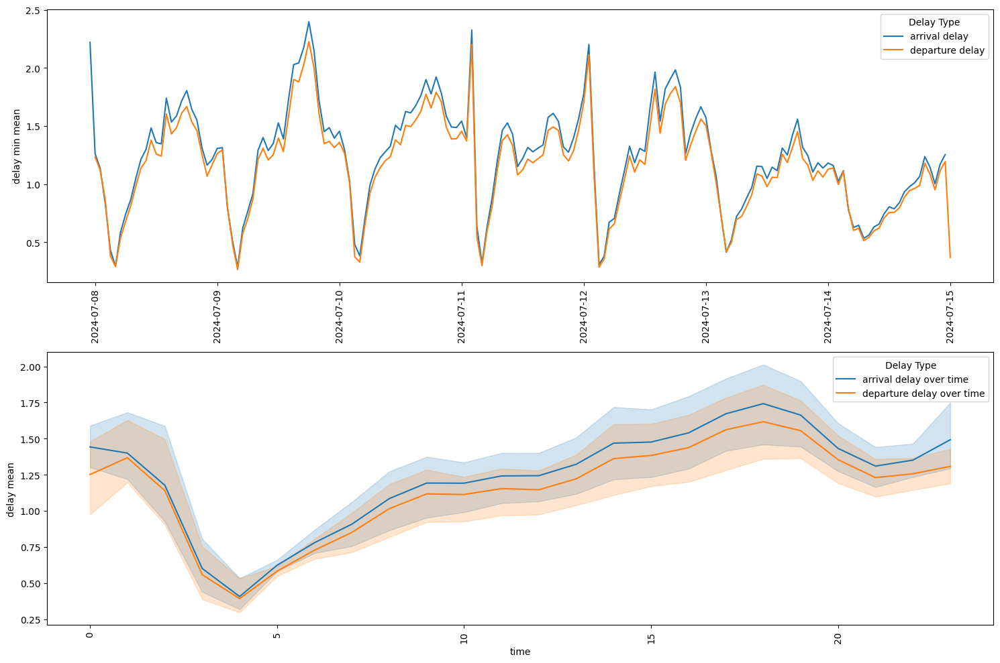

In [13]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_arr_plt, x="arrival_plan_datetime", y="arrival_delay_m", label="arrival delay", ax=axes[0])
sns.lineplot(df_temp_dep_plt, x="departure_plan_datetime", y="departure_delay_m", label="departure delay", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay min mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_arr_plt, x="arrival_plan_hour", y="arrival_delay_m", label="arrival delay over time", ax=axes[1])
sns.lineplot(df_temp_dep_plt, x="departure_plan_hour", y="departure_delay_m", label="departure delay over time", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


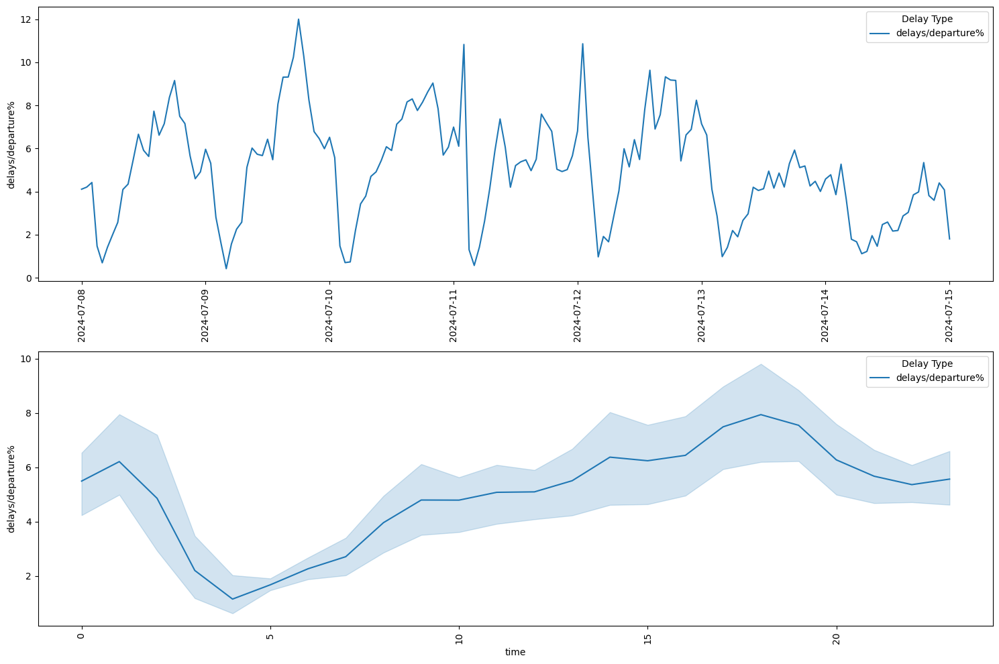

In [14]:
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival and departure delays over datetime
sns.lineplot(df_temp_cnt, x="departure_plan_datetime", y="delay_cnt/departure", label="delays/departure%", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delays/departure%")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Delay Type")

# Second plot: arrival and departure delays over time of day
sns.lineplot(df_temp_cnt, x="departure_plan_hour", y="delay_cnt/departure", label="delays/departure%", ax=axes[1])
axes[1].set_xlabel("time")
axes[1].set_ylabel("delays/departure%")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Delay Type")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


the data indicates a seasonality with peaks around late afternoon around 16:00.<br>
the gap on the 24th comes from a gap in the data collection around that time

as arrival and departure follow a similar temporal pattern, we will only discuss departure going further, as most departure delays also inherit arrival delays, but they can also be the source.

In [15]:
df_temp_cat = df_temp_dep.groupby(["departure_plan_datetime", "category"], as_index=False).departure_delay_m.mean()
df_temp_cat2 = df_temp_dep.groupby(["departure_plan_hour", "category"], as_index=False).departure_delay_m.mean()


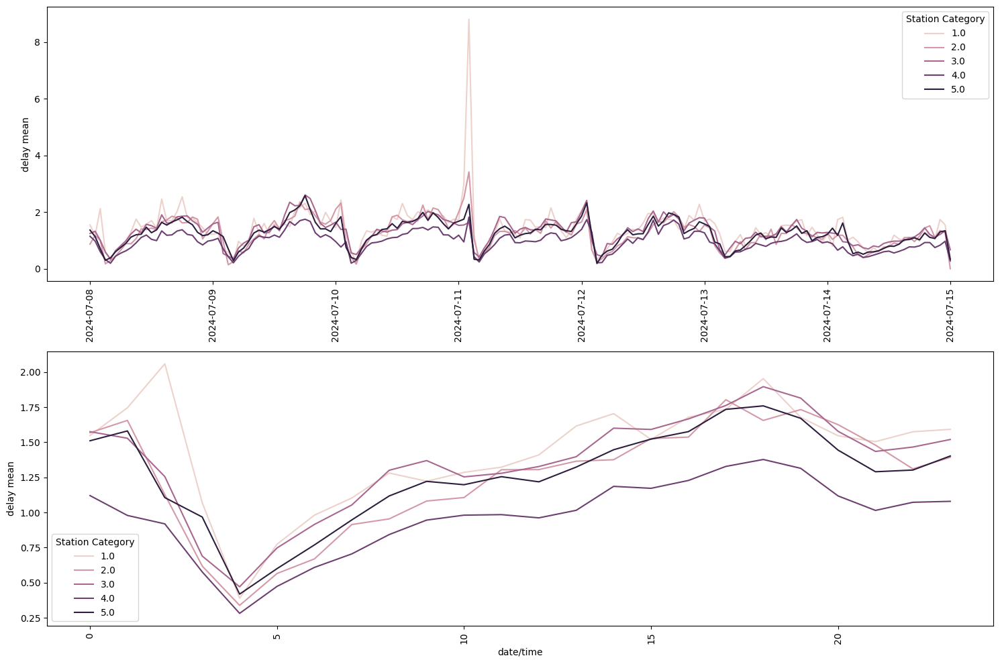

In [16]:
# Create a figure with two subplots arranged vertically
fig, axes = plt.subplots(nrows=2, figsize=(15, 10))

# First plot: arrival delays over datetime with category hue
sns.lineplot(df_temp_cat, x="departure_plan_datetime", y="departure_delay_m", hue="category", ax=axes[0])
axes[0].set_xlabel("")
axes[0].set_ylabel("delay mean")
axes[0].tick_params(axis='x', rotation=90)
axes[0].legend(title="Station Category")

# Second plot: arrival delays over time of day with category hue
sns.lineplot(df_temp_cat2, x="departure_plan_hour", y="departure_delay_m", hue="category", ax=axes[1])
axes[1].set_xlabel("date/time")
axes[1].set_ylabel("delay mean")
axes[1].tick_params(axis='x', rotation=90)
axes[1].legend(title="Station Category")

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


In [17]:
df.state.unique()


array(['Nordrhein-Westfalen', 'Baden-Württemberg', 'Niedersachsen',
       'Schleswig-Holstein', 'Bayern', 'Berlin', 'Hamburg', 'Thüringen',
       'Rheinland-Pfalz', 'Mecklenburg-Vorpommern', 'Sachsen',
       'Sachsen-Anhalt', 'Brandenburg', 'Hessen', 'Saarland', 'Bremen'],
      dtype=object)

In [18]:
statelist = df.state.unique()
frames = {}
for state in statelist:
    frames[state] = df[df["state"] == state]



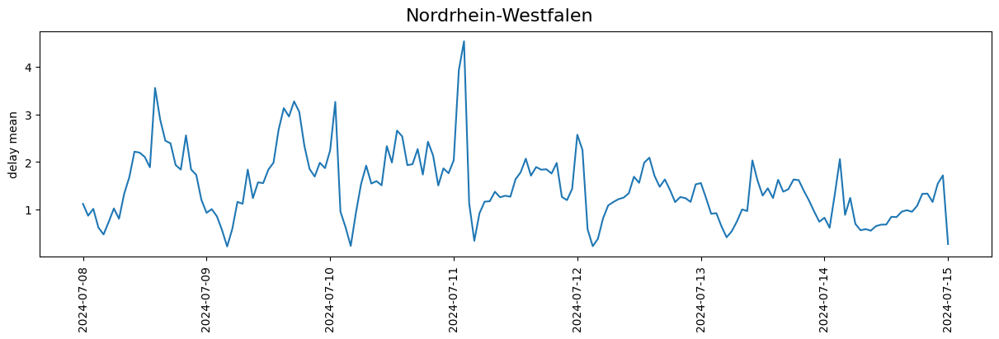

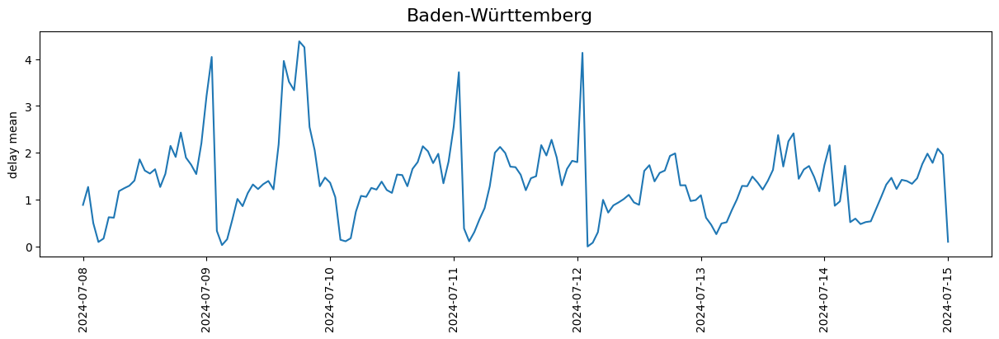

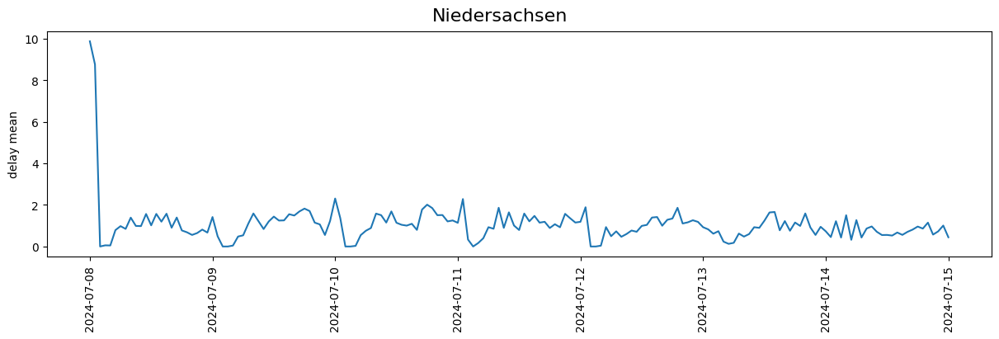

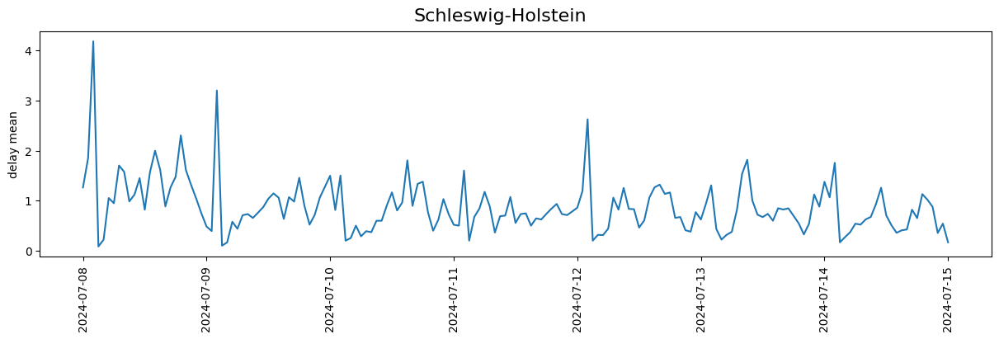

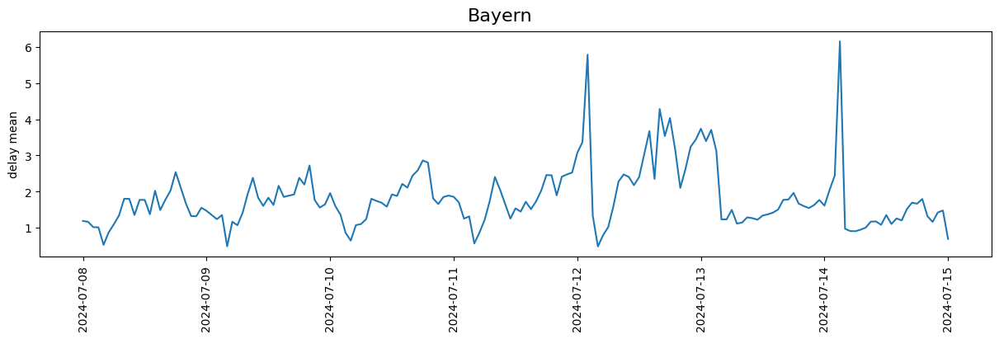

...

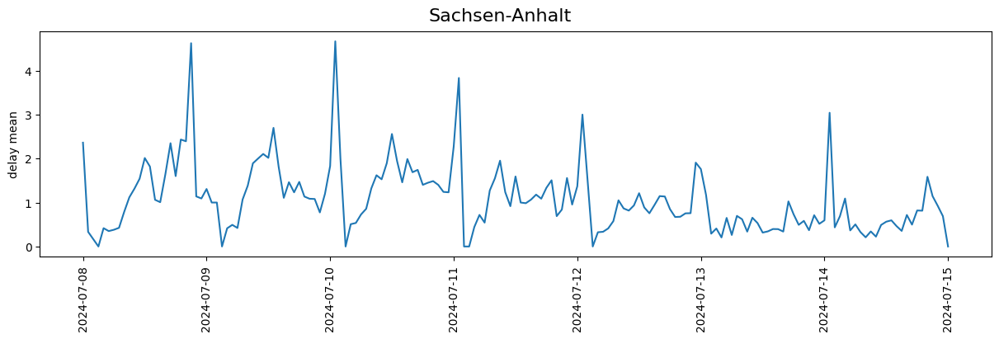

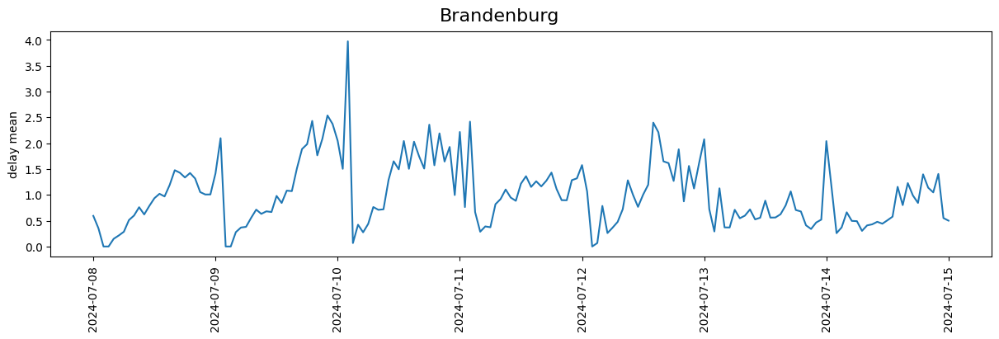

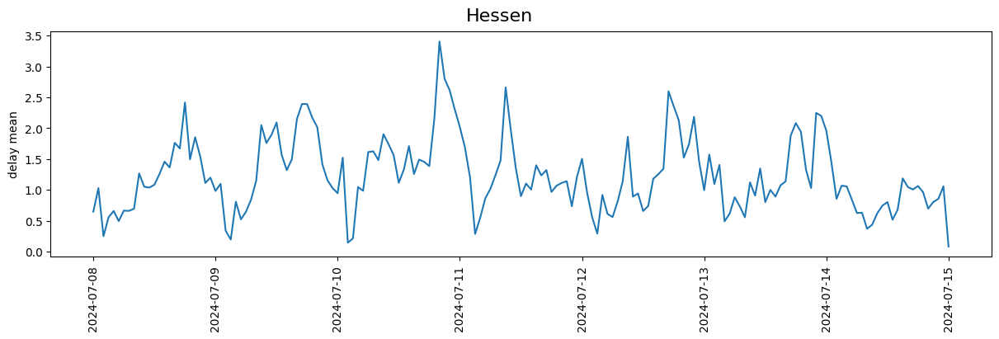

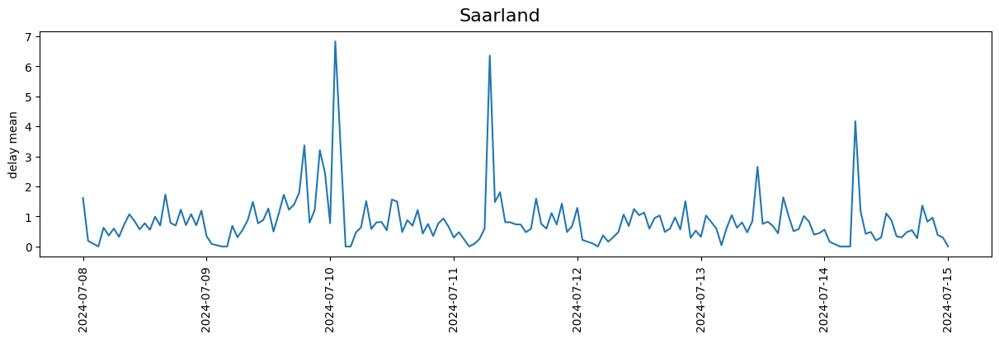

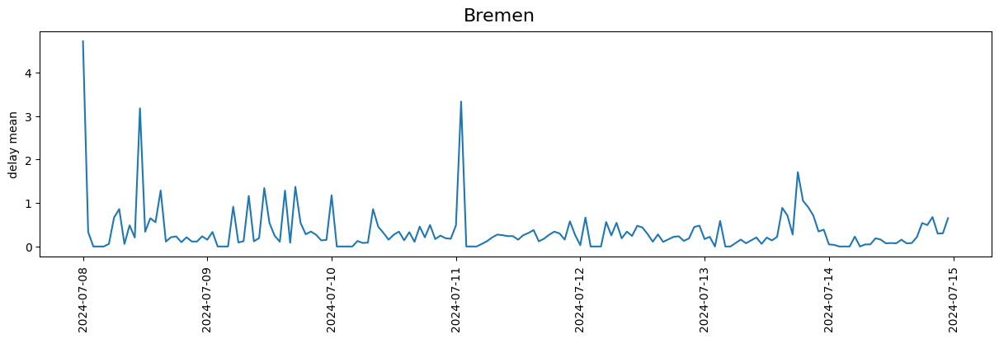

In [19]:
for state in statelist:
    fig, axes = plt.subplots(1, 1, figsize=(12, 4), constrained_layout=True)
    df_temp = frames[state].copy()
    df_temp.set_index('departure_plan', inplace=True)
    numeric_cols = df_temp.select_dtypes(include=['float64', 'int64'])
    hourly_data = numeric_cols.resample('h').mean()

    sns.lineplot(hourly_data, x=hourly_data.index,  y="departure_delay_m", ax=axes)
    axes.set_xlabel("")
    axes.set_ylabel("delay mean")
    axes.tick_params(axis='x', rotation=90)
    #axes.legend(title="Station Category")


    fig.suptitle(state, fontsize=16)
    plt.show()



Some states show more seasonality than others, while there are also several outliers present

In [20]:
heatmap_df2 = df_temp_dep.groupby(["station","departure_plan_datetime"], as_index=False ).mean(numeric_only=True)

In [21]:
fig = px.density_mapbox(
    heatmap_df2,
    lat='lat',
    lon='long',
    z='departure_delay_m',
    hover_name='station',
    radius=10,
    range_color=[0, heatmap_df2.departure_delay_m.max()],
    mapbox_style="carto-positron",
    center={"lat": 51.1657, "lon": 10.4515},
    zoom=5,
    width=600,
    height=700,
    title="Departure Delays over time",
    animation_frame="departure_plan_datetime"
)

fig.update_layout(
    margin={"r": 0, "t": 40, "l": 0, "b": 0},  # Reduced margins
    coloraxis_showscale=False
    )
fig.show()

In [22]:
del heatmap_df2, df_temp_arr, df

In [23]:
df_temp_dep.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,info,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,NaN,NaN,on_time,on_time,00:00:00,2024-07-08,00:01:00,2024-07-08,0,2024-07-08 00:00:00
1,18,NaN,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,NaN,NaN,on_time,on_time,NaT,NaT,00:17:00,2024-07-08,0,2024-07-08 00:00:00
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4.0,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,NaN,NaN,on_time,on_time,00:03:00,2024-07-08,00:04:00,2024-07-08,0,2024-07-08 00:00:00
3,18,Aachen Hbf,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08,0,2024-07-08 00:00:00
4,33,Herzogenrath|Kohlscheid,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaN,NaN,on_time,on_time,00:20:00,2024-07-08,00:21:00,2024-07-08,0,2024-07-08 00:00:00


In [24]:
time_format = "%H:%M:%S"
df_temp_dep["departure_plan_time"] = pd.to_datetime(df_temp_dep["departure_plan_time"], format=time_format)
df_temp_dep["departure_plan_minute"] = df_temp_dep["departure_plan_time"].dt.minute

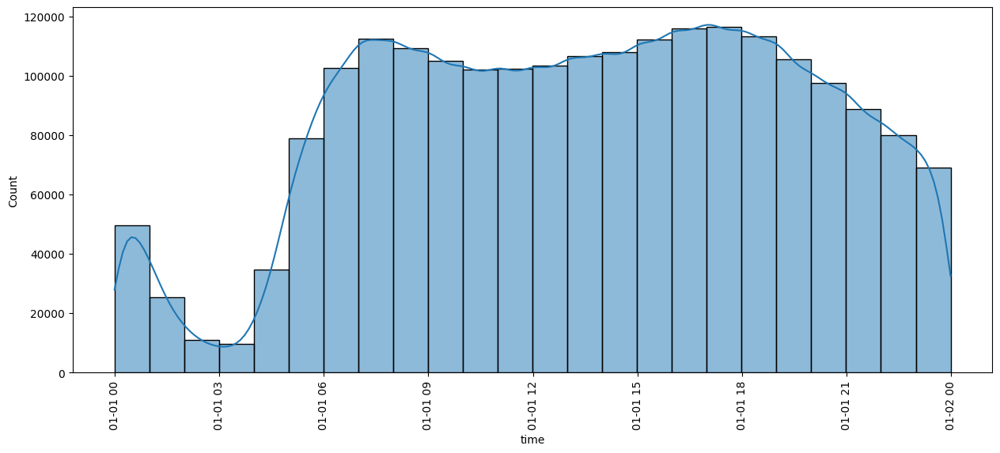

In [25]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
sns.histplot(df_temp_dep, x="departure_plan_time", ax=axes, bins=24, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)

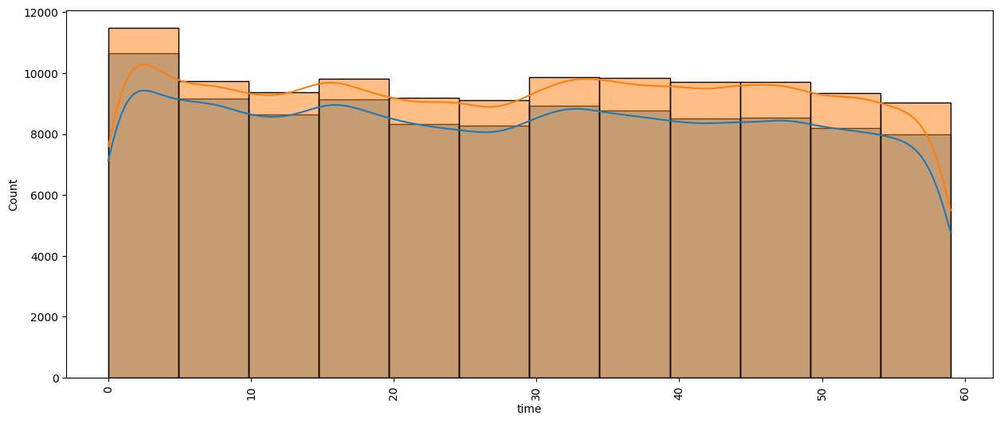

In [26]:
fig, axes = plt.subplots(ncols=1, figsize=(15, 6))
# First plot: arrival and departure delays over datetime
sns.histplot(df_temp_dep[df_temp_dep["departure_plan_hour"] == 9], bins=12, x="departure_plan_minute", label="9", ax=axes, alpha=0.5, kde=True)
sns.histplot(df_temp_dep[df_temp_dep["departure_plan_hour"] == 16],bins=12, x="departure_plan_minute", label="16", ax=axes, alpha=0.5, kde=True)
axes.set_xlabel("time")
axes.tick_params(axis='x', rotation=90)
#axes[0].get_legend().remove()

In [27]:
df_temp_dep.head()

,line,path,category,station,state,city,long,lat,arrival_plan,departure_plan,...,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,arrival_delay_check,departure_delay_check,arrival_plan_time,arrival_plan_date,departure_plan_time,departure_plan_date,departure_plan_hour,departure_plan_datetime,departure_plan_minute
0,20,Stolberg(Rheinl)Hbf Gl.44|Eschweiler-St.Jöris|...,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,2024-07-08 00:00:00,2024-07-08 00:01:00,...,NaN,on_time,on_time,00:00:00,2024-07-08,1900-01-01 00:01:00,2024-07-08,0,2024-07-08 00:00:00,1
1,18,NaN,2.0,Aachen Hbf,Nordrhein-Westfalen,Aachen,6.091499,50.767800,NaT,2024-07-08 00:17:00,...,NaN,on_time,on_time,NaT,NaT,1900-01-01 00:17:00,2024-07-08,0,2024-07-08 00:00:00,17
2,1,Hamm(Westf)Hbf|Kamen|Kamen-Methler|Dortmund-Ku...,4.0,Aachen-Rothe Erde,Nordrhein-Westfalen,Aachen,6.116475,50.770202,2024-07-08 00:03:00,2024-07-08 00:04:00,...,NaN,on_time,on_time,00:03:00,2024-07-08,1900-01-01 00:04:00,2024-07-08,0,2024-07-08 00:00:00,4
3,18,Aachen Hbf,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaN,on_time,on_time,00:20:00,2024-07-08,1900-01-01 00:21:00,2024-07-08,0,2024-07-08 00:00:00,21
4,33,Herzogenrath|Kohlscheid,5.0,Aachen West,Nordrhein-Westfalen,Aachen,6.070715,50.780360,2024-07-08 00:20:00,2024-07-08 00:21:00,...,NaN,on_time,on_time,00:20:00,2024-07-08,1900-01-01 00:21:00,2024-07-08,0,2024-07-08 00:00:00,21


In [28]:
df_temp_dep[df_temp_dep["station"].isin(worst)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,departure_plan_time,departure_plan_hour,departure_plan_minute
count,365358.000000,365358.000000,365358.000000,337445,365358,311341,331193,365358.000000,365358.000000,0.0,365358,365358.000000,365358.000000
mean,3.851882,8.908477,50.261417,2024-07-11 11:03:50.609314304,2024-07-11 10:58:56.269686272,2024-07-11 10:59:49.445977344,2024-07-11 10:52:54.378141952,2.366487,2.450845,NaN,1900-01-01 13:33:57.043174400,13.090366,28.528750
min,1.000000,6.097265,47.456591,2024-07-07 23:55:00,2024-07-08 00:00:00,2024-07-07 23:56:00,2024-07-08 00:00:00,0.000000,0.000000,NaN,1900-01-01 00:00:00,0.000000,0.000000
25%,3.000000,7.217830,48.815540,2024-07-09 17:11:00,2024-07-09 17:08:00,2024-07-09 17:19:00,2024-07-09 17:15:00,0.000000,0.000000,NaN,1900-01-01 08:54:00,8.000000,13.000000
50%,4.000000,8.573876,50.350929,2024-07-11 11:03:00,2024-07-11 10:58:00,2024-07-11 10:52:00,2024-07-11 10:44:00,0.000000,1.000000,NaN,1900-01-01 13:46:00,13.000000,29.000000
75%,5.000000,9.876266,51.292009,2024-07-13 01:43:00,2024-07-13 01:27:00,2024-07-13 00:54:00,2024-07-13 00:33:00,3.000000,3.000000,NaN,1900-01-01 18:22:00,18.000000,44.000000
max,5.000000,14.805774,54.872142,2024-07-14 23:59:00,2024-07-15 00:07:00,2024-07-15 01:03:00,2024-07-15 01:04:00,157.000000,156.000000,NaN,1900-01-01 23:59:00,23.000000,59.000000
std,1.070124,1.926259,1.514189,NaN,NaN,NaN,NaN,5.108970,5.109427,NaN,NaN,5.853154,17.633219


In [29]:
df_temp_dep[df_temp_dep["station"].isin(best)].describe()

,category,long,lat,arrival_plan,departure_plan,arrival_change,departure_change,arrival_delay_m,departure_delay_m,attention: datapoints 240711_04 - 240711_06 are simulated because of measurement issues,departure_plan_time,departure_plan_hour,departure_plan_minute
count,704755.000000,704755.000000,704755.000000,627283,704755,472170,517268,704755.000000,704755.000000,0.0,704755,704755.000000,704755.000000
mean,3.978093,11.615345,52.215941,2024-07-11 10:41:34.928541184,2024-07-11 10:41:29.472284416,2024-07-11 10:44:01.674058496,2024-07-11 10:36:04.260577024,0.385875,0.402842,NaN,1900-01-01 13:30:21.524415488,13.018791,29.231285
min,1.000000,6.074485,47.411032,2024-07-07 23:53:00,2024-07-08 00:00:00,2024-07-07 23:56:00,2024-07-08 00:00:00,0.000000,0.000000,NaN,1900-01-01 00:00:00,0.000000,0.000000
25%,4.000000,9.967204,52.215150,2024-07-09 17:13:00,2024-07-09 17:10:00,2024-07-09 17:09:00,2024-07-09 17:01:00,0.000000,0.000000,NaN,1900-01-01 08:47:00,8.000000,14.000000
50%,4.000000,12.374533,52.503497,2024-07-11 10:05:00,2024-07-11 10:07:00,2024-07-11 10:03:00,2024-07-11 09:52:00,0.000000,0.000000,NaN,1900-01-01 13:50:00,13.000000,29.000000
75%,5.000000,13.384547,53.460694,2024-07-13 00:38:00,2024-07-13 00:40:00,2024-07-13 01:22:00,2024-07-13 01:07:00,0.000000,0.000000,NaN,1900-01-01 18:21:00,18.000000,44.000000
max,5.000000,14.902088,54.906839,2024-07-14 23:59:00,2024-07-15 00:06:00,2024-07-15 00:26:00,2024-07-15 00:27:00,117.000000,134.000000,NaN,1900-01-01 23:59:00,23.000000,59.000000
std,0.837776,1.977515,1.399820,NaN,NaN,NaN,NaN,1.619343,1.651347,NaN,NaN,5.915146,17.401781


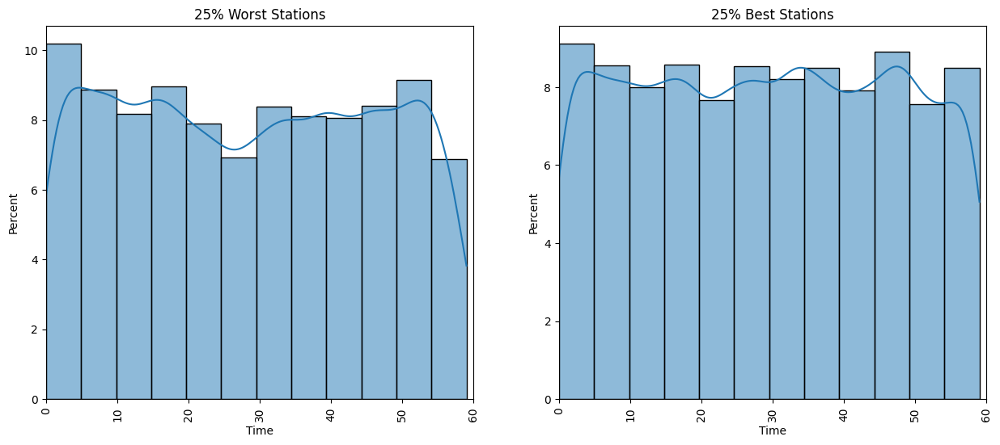

In [30]:
fig, axes = plt.subplots(ncols=2, figsize=(15, 6))



#sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 9)&(df_temp_dep["station"].isin(worst))], kde=True, bins=12, label="9", x="departure_plan_minute", ax=axes[0], alpha=0.5)
sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16)&(df_temp_dep["station"].isin(worst))], kde=True, bins=12, label="16", x="departure_plan_minute", ax=axes[0], alpha=0.5, stat="percent")
axes[0].set_xlabel("Time")
axes[0].tick_params(axis='x', rotation=90)
axes[0].set_title("25% Worst Stations")
axes[0].set_xlim([0,60])
#axe[0].get_legend().remove()


#sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 9)&(df_temp_dep["station"].isin(best))], kde=True,bins=12, label="9", x="departure_plan_minute", ax=axes[1], alpha=0.5)
sns.histplot(df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16)&(df_temp_dep["station"].isin(best))], kde=True,bins=12, label="16", x="departure_plan_minute", ax=axes[1], alpha=0.5, stat="percent")
axes[1].set_xlabel("Time")
axes[1].tick_params(axis='x', rotation=90)
#axes[1].legend(title="Time")
axes[1].set_title("25% Best Stations")
axes[1].set_xlim([0,60])

plt.show()


In [31]:
def calculate_histogram_bin_counts(data, bins, range):
    counts, _ = np.histogram(data, bins=bins, range=range)
    return counts

bins = 12
range = (0, 60)
data_worst = df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16) & (df_temp_dep["station"].isin(worst))]["departure_plan_minute"]
data_best = df_temp_dep[(df_temp_dep["departure_plan_hour"] == 16) & (df_temp_dep["station"].isin(best))]["departure_plan_minute"]

bin_counts_worst = calculate_histogram_bin_counts(data_worst, bins, range)
bin_counts_best = calculate_histogram_bin_counts(data_best, bins, range)

def gini_coefficient(bin_counts):
    sorted_counts = np.sort(bin_counts)
    n = len(bin_counts)
    index = np.arange(1, n + 1)
    return (2 * np.sum(index * sorted_counts) / (n * np.sum(sorted_counts))) - (n + 1) / n


gini_worst = gini_coefficient(bin_counts_worst)
gini_best = gini_coefficient(bin_counts_best)

print(f"Gini Coefficients \n Worst: {gini_worst.round(3)},\n Best: {gini_best.round(3)}")

Gini Coefficients 
 Worst: 0.058,
 Best: 0.031


The departure times are more evenly distributed at the 25% of best stations than the 25% of worst stations
